In [85]:
%run metrics.py

In [86]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np

def plot_voxels_side_by_side(voxel_datasets, titles, rows=0, cols=0, box_size=50):
    """
    Plot multiple 3D voxel grids in a single figure with a compact layout.

    Parameters:
    voxel_datasets (list of np.ndarray): List of 3D arrays representing voxel grids.
    titles (list of str): List of titles for the subplots.
    """
    if cols == 0 or rows == 0:
        num_plots = len(voxel_datasets)
        rows = int(np.ceil(num_plots / 3))  # 3-column layout
        cols = 3  

    fig = make_subplots(rows=rows, cols=cols, 
                        specs=[[{'type': 'scatter3d'}] * cols] * rows,
                        subplot_titles=titles)


    for i, (voxel_data, title) in enumerate(zip(voxel_datasets, titles)):
        row = (i // cols) + 1
        col = (i % cols) + 1
        x, y, z = np.where(voxel_data > 0)
        values = voxel_data[x, y, z] 

        scatter = go.Scatter3d(
            x=x, y=y, z=z,
            mode='markers',
            marker=dict(size=3, symbol='square', color=values, colorscale='Viridis', showscale=False),
            name=title
        )
        fig.add_trace(scatter, row=row, col=col)
        
        fig.update_scenes(
            dict(
                xaxis=dict(range=[0, box_size], title="X"),
                yaxis=dict(range=[0, box_size], title="Y"),
                zaxis=dict(range=[0, box_size], title="Z"),
                aspectratio=dict(x=1, y=1, z=1),
                aspectmode='cube'
            ),
            row=row, col=col
        )

    #Adjust height and width of the figure
    fig.update_layout(
        height=300 * rows,   
        width=400 * cols,    
        title="Voxel Grids",
        margin=dict(l=10, r=10, t=50, b=10)  # Reduce padding around the plots
    )
    
    # config = {"displayModeBar": False}
    
    fig.show()


In [87]:
def compare_deferred(metrics):    #borrowed from the Dark side
    names = []
    elements = []
    symmetry_checks = {}

    def append(name, ab):
        names.append(name)
        elements.append(ab)
        for metric_name, metric_fn in metrics:      #symmetry check
            value_ab = metric_fn(ab[0], ab[1])
            value_ba = metric_fn(ab[1], ab[0])
            symmetry_checks[(name, metric_name)] = 1 if value_ab == value_ba else 0
        return [metric(*ab) for name, metric in metrics]

    def table():
        # Determine column widths for formatting
        longest_metric_name_len = max(len(name) for name, _ in metrics)
        longest_name_len = max(max(len(name) for name in names), 6)

        print(" " * longest_metric_name_len, "|", end=" ")
        for name in names:
            print(name + " " * (longest_name_len - len(name)), "|", end=" ")
        print("Symmetry" + " " * (longest_name_len - 8), "|")

        print("-" * (longest_metric_name_len + 2 + (len(names) + 1) * (longest_name_len + 3)))

        for metric_name, metric_fn in metrics:
            print(" " * (longest_metric_name_len - len(metric_name)) + metric_name, "|", end=" ")
            for i, (a, b) in enumerate(elements):
                value = repr(round(metric_fn(a, b), min(longest_name_len - 2, 4)))
                print(value + " " * (longest_name_len - len(value)), "|", end=" ")
            symmetry = all(symmetry_checks[(name, metric_name)] for name in names)
            print(f"{symmetry}       |")

    return append, table


metrics = [
    ("TVD", total_variation_distance),
    # ("Wasserstein 3D", wasserstein_distance_3d),
    ("Wasserstein 3D optimized", wasserstein_distance_3d_optimized),
    ("Wasserstein 3D optimized and normalized", wasserstein_distance_3d_optimized_normalized),
    # ("Wasserstein 3D optimized and normalized with avg distance", wasserstein_distance_3d_average_distance),
    # ("GMSD", gradient_magnitude_similarity_deviation),
    ("Q-Score", compute_q_score)
]

#### Gaussian blobs, normalized environment

In [88]:
voxel_basic = np.load("voxel_base.npy")
voxel_different_hole = np.load("voxel_different_hole.npy")
voxel_different = np.load("voxel_different.npy")
voxel_loss_big = np.load("voxel_loss_big.npy")
voxel_loss_small = np.load("voxel_loss_small.npy")
voxel_with_blob = np.load("voxel_with_blob.npy")
voxel_negative_blob = np.load("voxel_negative_blob.npy")

#### Different, 2x bigger voxels

In [89]:
big_basic = np.load("voxel_big_base.npy")
big_growth = np.load("voxel_big_growth.npy")
big_loss_big = np.load("voxel_big_loss_big.npy")
big_loss_small = np.load("voxel_big_loss_small.npy")

#### Blobs from the Dark side

In [90]:
blob_perfect = np.load("perfect_blob.npy")
blob_cut = np.load("cut_blob.npy")
blob_perfect = blob_perfect*np.max(blob_cut)


#### Moved voxels

In [91]:
moved1 = np.load("voxel_moved1.npy")
moved2 = np.load("voxel_moved2.npy")
moved3 = np.load("voxel_moved3.npy")
moved4 = np.load("voxel_moved4.npy")

Moved small

In [92]:
moved1_s = np.load("voxel_moved1_s.npy")
moved2_s = np.load("voxel_moved2_s.npy")
moved3_s = np.load("voxel_moved3_s.npy")
moved4_s = np.load("voxel_moved4_s.npy")

In [93]:
empty = np.load("voxel_empty.npy")
full = np.load("voxel_full.npy")
one = np.load("voxel_one_pixel.npy")
left_bottom = np.load("voxel_left_bottom.npy")
right_top = np.load("voxel_right_top.npy")


### Simplest blobs

In [94]:
voxel_pairs = [
    ("Basic", voxel_basic),
    ("Different", voxel_different),
    ("Small Loss", voxel_loss_small),
    ("Big Loss", voxel_loss_big),
    ("With Growth", voxel_with_blob),
    ("Hole", voxel_different_hole),
    ("Negative", voxel_negative_blob)
]
compare_append, compare_table = compare_deferred(metrics)

#All comparisons
for (name, v1) in voxel_pairs:
    compare_append(f"Basic to {name}", [voxel_basic, v1])

compare_table()


voxel_names, voxel_data = zip(*voxel_pairs)
plot_voxels_side_by_side(voxel_data, voxel_names, 2, 4)


                                        | Basic to Basic       | Basic to Different   | Basic to Small Loss  | Basic to Big Loss    | Basic to With Growth | Basic to Hole        | Basic to Negative    | Symmetry             |
---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                    TVD | 1.0                  | 0.9598               | 0.9998               | 0.9987               | 0.9988               | 0.9636               | 0.0046               | True       |
               Wasserstein 3D optimized | 1.0                  | 0.9459               | 0.9978               | 0.986                | 0.9902               | 0.9456               | 0.8955               | False       |
Wasserstein 3D optimized and normalized | 1.0                  | 0.798                | 0.9868               | 0.91

#### Similarity scores in bigger scale

In [95]:
voxel_pairs_big = [
    ("BigBasic", big_basic),
    ("BigSmall Loss", big_growth),
    ("BigBig Loss", big_loss_big),
    ("BigWith Growth", big_loss_small)
]
compare_append, compare_table = compare_deferred(metrics)

#All comparisons
for (name, v1) in voxel_pairs_big:
    compare_append(f"BigBasic to {name}", [big_basic, v1])

compare_table()


voxel_names, voxel_data = zip(*voxel_pairs_big)
plot_voxels_side_by_side(voxel_data, voxel_names, 2, 2, 100)


                                        | BigBasic to BigBasic       | BigBasic to BigSmall Loss  | BigBasic to BigBig Loss    | BigBasic to BigWith Growth | Symmetry                   |
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                    TVD | 1.0                        | 0.9993                     | 0.996                      | 0.9971                     | True       |
               Wasserstein 3D optimized | 1.0                        | 0.9982                     | 0.9896                     | 0.9882                     | False       |
Wasserstein 3D optimized and normalized | 1.0                        | 0.9927                     | 0.9578                     | 0.9522                     | False       |
                                Q-Score | 1.0                        | 0.9873                     | 0.9215     

#### Similarity scores for perfect and cut

In [96]:
voxel_pairs_big = [
    ("Perfect", blob_perfect),
    ("Cut", blob_cut),
]
compare_append, compare_table = compare_deferred(metrics)

#All comparisons
for (name, v1) in voxel_pairs_big:
    compare_append(f"Perfect to {name}", [blob_perfect, v1])

compare_table()


voxel_names, voxel_data = zip(*voxel_pairs_big)
plot_voxels_side_by_side(voxel_data, voxel_names, 1, 2, 200)


                                        | Perfect to Perfect | Perfect to Cut     | Symmetry           |
--------------------------------------------------------------------------------------------------------
                                    TVD | 1.0                | 0.9981             | True       |
               Wasserstein 3D optimized | 1.0                | 0.9607             | False       |
Wasserstein 3D optimized and normalized | 1.0                | 0.8721             | False       |
                                Q-Score | 1.0                | 0.0815             | True       |


## Scores for rescaled voxels

In [97]:
voxel_basic = np.load("voxel_base.npy")
linear2 = np.load("voxel_linearly2.npy")
linear5 = np.load("voxel_linearly5.npy")
nonlinear2 = np.load("voxel_non-linearly2.npy")
nonlinear5 = np.load("voxel_non-linearly5.npy")

voxel_pairs_big = [
    ("Basic", voxel_basic),
    ("Linear2", linear2),
    ("Linear5 ", linear5),
    ("Nonlin2", nonlinear2),
    ("Nonlin5", nonlinear5)
]
compare_append, compare_table = compare_deferred(metrics)

#All comparisons
for (name, v1) in voxel_pairs_big:
    compare_append(f"Basic to {name}", [voxel_basic, v1])

compare_table()


voxel_names, voxel_data = zip(*voxel_pairs_big)
plot_voxels_side_by_side(voxel_data, voxel_names, 2, 3, 50)

                                        | Basic to Basic    | Basic to Linear2  | Basic to Linear5  | Basic to Nonlin2  | Basic to Nonlin5  | Symmetry          |
-----------------------------------------------------------------------------------------------------------------------------------------------------------------
                                    TVD | 1.0               | 0.9924            | 0.9697            | 0.9992            | 0.9971            | True       |
               Wasserstein 3D optimized | 1.0               | 1.0               | 1.0               | 0.9994            | 0.9966            | False       |
Wasserstein 3D optimized and normalized | 1.0               | 1.0               | 1.0               | 0.9962            | 0.9795            | False       |
                                Q-Score | 1.0               | 1.0               | 1.0               | 0.9954            | 0.8629            | True       |


### Empty, one, full scores

In [98]:
voxel_pairs_edge = [
    ("Empty", empty),
    ("Full", full),
    ("One ", one),
    ("LeftBottom", left_bottom),
    ("RightTop", right_top)
]
compare_append, compare_table = compare_deferred(metrics)

#All comparisons
compare_append(f"Empty to full", [empty, full])
compare_append(f"Full to one", [full, one])
compare_append(f"Empty to one", [empty, one])
compare_append(f"LeftBottom to RightTop", [left_bottom, right_top])

compare_table()
voxel_names, voxel_data = zip(*voxel_pairs_edge)
plot_voxels_side_by_side(voxel_data, voxel_names, 2, 3, 50)



plot_voxels_side_by_side(
    [empty, full, one, left_bottom, right_top],
    ["Empty", "Full", "One", "Left Bottom", "Right Top"])


                                        | Empty to full          | Full to one            | Empty to one           | LeftBottom to RightTop | Symmetry               |
----------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                    TVD | 0.0                    | 0.0                    | 1.0                    | 0.9999                 | True       |
               Wasserstein 3D optimized | 0.0                    | 0.0                    | 1.0                    | 0.52                   | True       |
Wasserstein 3D optimized and normalized | 0.0                    | 0.0                    | 1.0                    | 0.0                    | True       |
                                Q-Score | 0                      | 0                      | 0                      | -0.0001                | True       |


## Moved scores

In [99]:
voxel_pairs =[
    ("Moved1", moved1),
    ("Moved2", moved2),
    ("Moved3", moved3),
    ("Moved4", moved4)
]
compare_append, compare_table = compare_deferred(metrics)

#All moves
for (name, v1) in voxel_pairs:
    compare_append(f"Moved1 to {name}", [moved1, v1])
    
compare_table()

voxel_names, voxel_data = zip(*voxel_pairs)
plot_voxels_side_by_side(voxel_data, voxel_names, 1, 4)

                                        | Moved1 to Moved1 | Moved1 to Moved2 | Moved1 to Moved3 | Moved1 to Moved4 | Symmetry         |
----------------------------------------------------------------------------------------------------------------------------------------
                                    TVD | 1.0              | 0.9984           | 0.9984           | 0.9984           | True       |
               Wasserstein 3D optimized | 1.0              | 0.9707           | 0.9418           | 0.913            | False       |
Wasserstein 3D optimized and normalized | 1.0              | 0.6485           | 0.4486           | 0.332            | False       |
                                Q-Score | 1.0              | 0.0002           | -0.0009          | -0.0009          | True       |


In [100]:
voxel_pairs =[
    ("Moved1_s", moved1_s),
    ("Moved2_s", moved2_s),
    ("Moved3_s", moved3_s),
    ("Moved4_s", moved4_s)
]
compare_append, compare_table = compare_deferred(metrics)

#All moves
for (name, v1) in voxel_pairs:
    compare_append(f"Moved1 to {name}", [moved1_s, v1])
    
compare_table()

voxel_names, voxel_data = zip(*voxel_pairs)
plot_voxels_side_by_side(voxel_data, voxel_names, 1, 4)

                                        | Moved1 to Moved1_s | Moved1 to Moved2_s | Moved1 to Moved3_s | Moved1 to Moved4_s | Symmetry           |
--------------------------------------------------------------------------------------------------------------------------------------------------
                                    TVD | 1.0                | 0.9964             | 0.9964             | 0.9965             | True       |
               Wasserstein 3D optimized | 1.0                | 0.9414             | 0.8838             | 0.8294             | True       |
Wasserstein 3D optimized and normalized | 1.0                | 0.4216             | 0.2538             | 0.1499             | False       |
                                Q-Score | 1.0                | -0.0021            | -0.0021            | -0.002             | True       |


## Dark side blobs


In [101]:
def plot_voxels_side_by_side(voxel_datasets, titles, rows=0, cols=0, box_size=50):
    """
    Plot multiple 3D voxel grids in a single figure with a compact layout.

    Parameters:
    voxel_datasets (list of np.ndarray): List of 3D arrays representing voxel grids.
    titles (list of str): List of titles for the subplots.
    """
    if cols == 0 or rows == 0:
        num_plots = len(voxel_datasets)
        rows = int(np.ceil(num_plots / 3))  # 3-column layout
        cols = 3  

    fig = make_subplots(rows=rows, cols=cols, 
                        specs=[[{'type': 'scatter3d'}] * cols] * rows,
                        subplot_titles=titles)


    for i, (voxel_data, title) in enumerate(zip(voxel_datasets, titles)):
        row = (i // cols) + 1
        col = (i % cols) + 1
        x, y, z = np.where(voxel_data > 0)
        values = voxel_data[x, y, z] 

        scatter = go.Scatter3d(
            x=x, y=y, z=z,
            mode='markers',
            marker=dict(size=3, symbol='square', color=values, colorscale='Viridis', showscale=False),
            name=title
        )
        fig.add_trace(scatter, row=row, col=col)
        
        fig.update_scenes(
            dict(
                xaxis=dict(range=[-box_size, box_size], title="X"),
                yaxis=dict(range=[-box_size, box_size], title="Y"),
                zaxis=dict(range=[-box_size, box_size], title="Z"),
                aspectratio=dict(x=1, y=1, z=1),
                aspectmode='cube'
            ),
            row=row, col=col
        )

    #Adjust height and width of the figure
    fig.update_layout(
        height=300 * rows,   
        width=400 * cols,    
        title="Voxel Grids",
        margin=dict(l=10, r=10, t=50, b=10)  # Reduce padding around the plots
    )
    
    # config = {"displayModeBar": False}
    
    fig.show()

In [102]:
res3_1_hcy6 = np.load("data/data/6HCY_C_501_NAP.npz")
res3_1_hcy_t = np.load("data/data/6HCY_C_501_NAP_T.npz")
plot_voxels_side_by_side([res3_1_hcy6["arr_0"], res3_1_hcy_t["arr_0"]], ["6HCY_C_501_NAP", "6HCY_C_501_NAP_T"], 1, 2, 30)

res4_36_5aco = np.load("data/data/5ACO_w_3_BMA.npz")
res4_36_5aco_t = np.load("data/data/5ACO_w_3_BMA_T.npz")
plot_voxels_side_by_side([res4_36_5aco["arr_0"], res4_36_5aco_t["arr_0"]], ["5ACO_w_3_BMA", "5ACO_w_3_BMA_T"], 1, 2, 20)

---------
#### -->>Added compare_deferred(metrics). Example usage:<br>
 voxel_pairs = [<br>
> ("Name1", voxel1),<br>
>      ("Name2", voxel2),]<br>

compare_append, compare_table = compare_deferred(metrics)<br>

 for (name, v1) in voxel_pairs:<br>
>     compare_append(f"Basic_voxel_for_comparison to {name}", [basic_voxel_for_comparison, v1])<br>

 compare_table()<br>


 voxel_names, voxel_data = zip(*voxel_pairs_big)<br>
 plot_voxels_side_by_side(voxel_data, voxel_names, 2, 3, 50)<br>


Dariusz Brzezinski
  3:16 PM
Spróbować znormalizować nowe miary (Z-score?, coś innego?)
Wymyślić: Research Questions:
    Czy miary biora pod uwagę dodawanie gęstości
    Czy biorą pod uwagę usuwanie
    Czy symetrycznie traktują dodawanie/odejmowanie gęstości
    Czy zależą mocno od wymodelowanego otoczenia
    Czy są wrażliwe na przesunięcia (odległość)
    Jaki jest teoretyczny min-max każdej miary
    Czy da się określić dobry punkt odcięcia - dobry/zły ligand
    Czy są zależne od rozdzielczości?
Spróbować odpowiedzieć na te pytania za pomocą danych syntetycznych
Przykład/problemy/future work związane z danymi prawdziwymi

---------------
WD:
- Gestosc: Liniowo bez zmian, ^2, ^5 generuje niewielkie roznice
- Usuwanie: Niewielkie zmieny (up to 0.2)
- Symetryczne usuwanie/dodawanie: Not really. (wszystko w zakresie 0.0x)
- Modelowanie otoczenie: ?
- Wraliwe na przesuniecia: tak. top-left-botton-right: 0.52. Lekkie ruszanie (not overlaping) 0.8.=>wieksza wrazliwosc potrzebna
- min-max: 0-1
- punkt odciecia: ?
- rozdzielczosc: ?

------------------------
Changes done at 21/01
### TVD
- is shit. No value below 0.95. not enough sensitive for any kind of comparison. Linear, nonlinear, movement, growth, loss is all the same for TVD.
- reacts to negative blob the most 0.03. this it only result below 0.95 for TVD
- theoretical <0,1>

### WD
- is symmetric. The difference is at e-10
- provide most sense for moving. The further away blobs are the lower the score 
- !!! implementacja WD nie jest już zalezna od boxu! Normalizacja względem wielkości boxu (biggest possible distance) !!!
  - zastosowana została normalizacja przez 'tozmiar przestrzeni zajmowanej przez dane' tzn. niezerowe voxele, czyli przez maksymalną odległość między niezerowymi voxelami spośród grid1 i grid2

- doesnt matter the value in blob, just its placement
- theoretical <0,1>
- in actual state of implementation, the cutoff makes sense only for movement. For loss or growth on our scale its only difference of maximum 0.06 (metric is 0.94) for different blobs (the metric is 0.19 for qscore). 
- value 0.91 in cluttered background suggests that any comparison with this value should be considered bad. Cutoff at 94 /95? Based on basic-diff, negative and basic-hole. All moved voxels are below any cutoff

### Qscore
- only one sensitive to nonlinear ^5 change. All others test result in almost 1.0 across all metrics. Suggests that for Qscrore not only placement, but also value (of voxels) matters. Only big differences tho.
- not sensitive to movement  
- theoretical <-1,1>


### For all metrics
- it doesn’t matter if growth is closer to center of mass or further away. What matters the most is the number of nonzero voxels.
- scale doesn’t matter. Below comparison of 50x50x50 and 100x100x100 in test for center of mass. Results were very similar.

 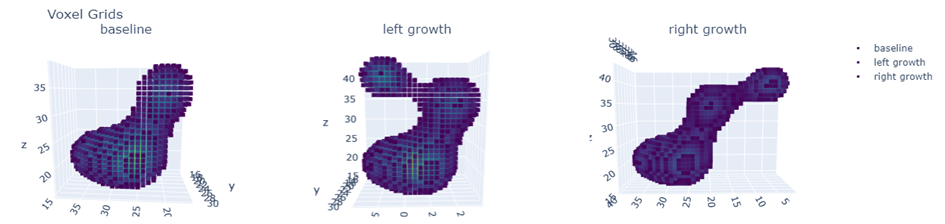
 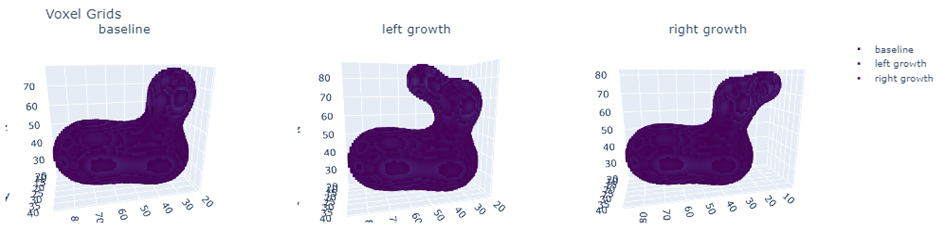

### Important considerations: 
- only possible comparisons for the same size of grids
- normal blobs are of values <0, around 1.6>
- nonlinear ^5 values  are up to 11


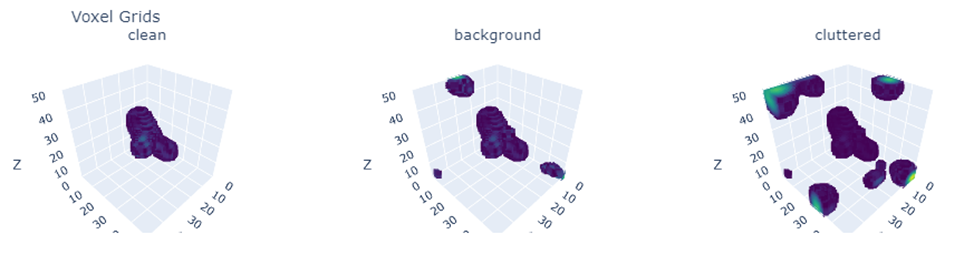
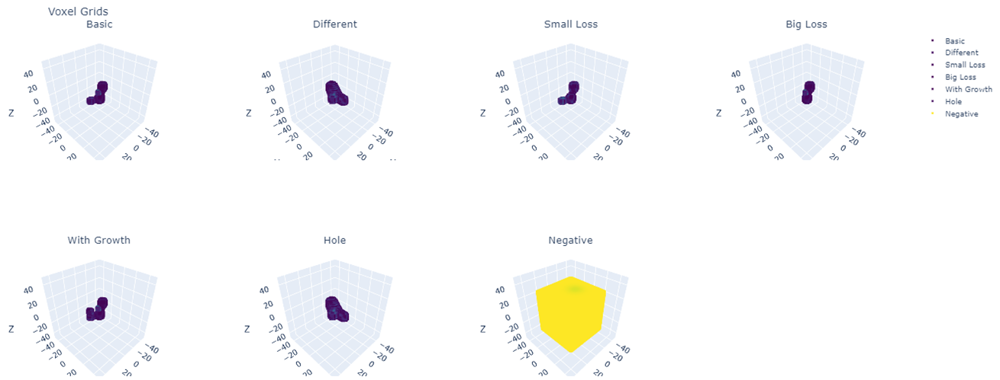
